In [1]:
import pandas as pd
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objects as go

import nltk
import string

from transformers import AutoTokenizer
from transformers import AutoModelForSequenceClassification
import math
from copy import deepcopy

import pickle
from tqdm.notebook import tqdm

from collections import OrderedDict
import math
from datetime import datetime

In [2]:
df = Path('df/')
ama_path = df/'amazon.csv'

In [3]:
#Read in the amazon review data
amazon = pd.read_csv(ama_path, index_col=0)
amazon

,rating,verified,date,description,summary,asin,fish,name
0,5.0,False,1285632000,Why so excited? Because I have been trying the...,I give it 5 Shining Stars!,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
1,4.0,False,1131494400,I use it to give many dishes that special some...,Good not tinny,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
2,5.0,True,1307059200,I just received my order of canned Red Head Wi...,Delicious Red Head Wild Sockeye Salmon!!!!!,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
3,1.0,True,1302825600,Ordered a few cases. It's barely edible. Too s...,"Too salty, tastes lousy",B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
4,5.0,True,1290124800,I've tried salmon before. Whether it was fres...,So much great flavor! Mmm :),B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
...,...,...,...,...,...,...,...,...
10251,5.0,True,1517788800,Delicious. Perfect for an on the go lunch. G...,Perfect for an on the go lunch,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10252,5.0,True,1517443200,My family love these. The Ranch and Hickory s...,Great Snack,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10253,1.0,True,1517356800,"In general, I love tuna. However, this is the...",I love tuna. However,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10254,5.0,True,1517097600,These are awesome for easy work lunches.,Tasty and easy,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."


In [8]:
#Removing newline characters from reviews
for n, row in amazon.iterrows():
    if '\n' in row['description']:
        row['description'] = " ".join(row['description'].split())

In [9]:
nltk.download("stopwords")
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('punkt')
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\wawil\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\wawil\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\wawil\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\wawil\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [10]:
#Using Natural Language Processing techniques to standardize the descriptions and remove filler words

def preprocess_text(text):

    # Tokenize the text

    tokens = word_tokenize(text.lower())




    # Remove stop words

    filtered_tokens = [token for token in tokens if token not in stopwords.words('english')]




    # Lemmatize the tokens

    lemmatizer = WordNetLemmatizer()

    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in filtered_tokens]




    # Join the tokens back into a string

    processed_text = ' '.join(lemmatized_tokens)

    return processed_text

In [11]:
#Dropping irrelevent columns
vader_amazon = amazon.copy()
vader_amazon.drop(columns=['summary', 'verified'], inplace=True)
vader_amazon

,rating,date,description,asin,fish,name
0,5.0,1285632000,Why so excited? Because I have been trying the...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
1,4.0,1131494400,I use it to give many dishes that special some...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
2,5.0,1307059200,I just received my order of canned Red Head Wi...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
3,1.0,1302825600,Ordered a few cases. It's barely edible. Too s...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
4,5.0,1290124800,I've tried salmon before. Whether it was fres...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
...,...,...,...,...,...,...
10251,5.0,1517788800,Delicious. Perfect for an on the go lunch. G...,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10252,5.0,1517443200,My family love these. The Ranch and Hickory s...,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10253,1.0,1517356800,"In general, I love tuna. However, this is the...",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10254,5.0,1517097600,These are awesome for easy work lunches.,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."


In [12]:
#Applying the NLP preprocessing
for n, row in tqdm(vader_amazon.iterrows(), total = len(vader_amazon)):
    vader_amazon['description'][n] = preprocess_text(row['description'])

vader_amazon

  0%|          | 0/10256 [00:00<?, ?it/s]

C:\Users\wawil\AppData\Local\Temp/ipykernel_22676/3080633033.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vader_amazon['description'][n] = preprocess_text(row['description'])


,rating,date,description,asin,fish,name
0,5.0,1285632000,excited ? trying soupbases minor 's year add d...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
1,4.0,1131494400,use give many dish special something . prefer ...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
2,5.0,1307059200,received order canned red head wild sockeye sa...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
3,1.0,1302825600,ordered case . 's barely edible . salty . may ...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
4,5.0,1290124800,'ve tried salmon . whether fresh canned . one ...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
...,...,...,...,...,...,...
10251,5.0,1517788800,delicious . perfect go lunch . good cracker .,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10252,5.0,1517443200,"family love . ranch hickory smoke , fave .",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10253,1.0,1517356800,"general , love tuna . however , exception . sp...",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10254,5.0,1517097600,awesome easy work lunch .,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."


In [13]:
#Getting a list of the unique types of fish in the products
fish_list = vader_amazon['fish'].unique()

In [14]:
review_adj = {}

#Iterating through the data to identify adjectives and other descriptive words
for n, row in tqdm(vader_amazon.iterrows(), total = len(vader_amazon)):
    
    #For each review; store the rating, type of fish, all of the selected words and their count
    review_adj[n] = {}
    review_adj[n]['fish'] = row['fish']
    review_adj[n]['rating'] = row['rating']
    review_adj[n]['words'] = {}
    
    #Separating each string into tokens and removing any punctuation from the beginning or end of words to ensure clean data
    tokens = word_tokenize(row['description'].translate(str.maketrans('', '', string.punctuation)))
    
    #Identifyng the Part of Speech (PoS) of each token
    pos = nltk.pos_tag(tokens)
    
    for m in range(len(pos)):
        
        #Picks out all words identified as adjectives/descriptive that are more than 2 characters
        if pos[m][1] == 'JJ' and pos[m][0] not in review_adj[n]['words'].keys() and len(pos[m][0]) > 2:
            
            review_adj[n]['words'][pos[m][0]] = 1
        
        #Counts repeated uses of words in a review
        elif pos[m][1] == 'JJ' and len(pos[m][0]) > 2:
            review_adj[n]['words'][pos[m][0]] += 1
print(review_adj)

  0%|          | 0/10256 [00:00<?, ?it/s]

{0: {'fish': 'Clams', 'rating': 5.0, 'words': {'minor': 1, 'official': 1, 'new': 1, 'fine': 1, 'red': 1, 'chopped': 1, 'delicious': 1, 'several': 1, 'particular': 1, 'good': 1, 'last': 1, 'clam': 2, 'fish': 2, 'tasty': 3, 'late': 1, 'convey': 1, 'stew': 1, 'great': 1, 'love': 1, 'bought': 1, 'local': 1, 'sure': 1, 'dish': 1, 'fresh': 1, 'demographic': 1}}, 1: {'fish': 'Clams', 'rating': 4.0, 'words': {'give': 1, 'many': 1, 'dish': 1, 'special': 1, 'sharp': 1}}, 2: {'fish': 'Salmon', 'rating': 5.0, 'words': {'red': 1, 'sockeye': 1, 'wait': 1, 'real': 1, 'salmon': 1, 'happy': 1, 'delicious': 1}}, 3: {'fish': 'Salmon', 'rating': 1.0, 'words': {'ordered': 1, 'edible': 1, 'shame': 1, 'poor': 1, 'lousy': 1, 'unhealthy': 1, 'despicable': 1, 'palatable': 1, 'corporate': 1}}, 4: {'fish': 'Salmon', 'rating': 5.0, 'words': {'salmon': 1, 'fresh': 1, 'wow': 1, 'great': 2, 'first': 1, 'particular': 1, 'mixed': 2, 'frozen': 1, 'green': 1, 'microwave': 1, 'simple': 1, 'bite': 1, 'want': 1, 'low': 1}},

In [15]:
adj_com = {}

for fish in fish_list:
    
    adj_com[fish] = {}
            
adj_com

{'Clams': {},
 'Salmon': {},
 'Tuna Fish': {},
 'Anchovies': {},
 'Sardines': {},
 'Oysters': {},
 'Mackerel': {},
 'Seafood': {},
 'Herring': {},
 'Crabmeat': {},
 'Mussels & Cockles': {},
 'Trout': {}}

In [16]:
#Takes the previous data and organizes it by fish
for n in tqdm(review_adj, total = len(review_adj)):
    
    #Tests if a word is already in a fish's list by going through each selected word in each review
    for word in review_adj[n]['words'].keys():
        
        #Testing if the word has already been added. If it hasn't a new entry is made
        #This counts the occurances of each word and the distribution of their ratings
        if word not in adj_com[review_adj[n]['fish']].keys():
            
            adj_com[review_adj[n]['fish']][word] = {}
            
            adj_com[review_adj[n]['fish']][word]['total'] = review_adj[n]['words'][word]
            adj_com[review_adj[n]['fish']][word]['rating'] = {}
            
            for m in range(1,6):
        
                adj_com[review_adj[n]['fish']][word]['rating'][m] = 0
            
            adj_com[review_adj[n]['fish']][word]['rating'][review_adj[n]['rating']] = review_adj[n]['words'][word]
            
        else:
            
            adj_com[review_adj[n]['fish']][word]['total'] += review_adj[n]['words'][word]
            adj_com[review_adj[n]['fish']][word]['rating'][review_adj[n]['rating']] += review_adj[n]['words'][word]
            
adj_com

  0%|          | 0/10256 [00:00<?, ?it/s]

{'Clams': {'minor': {'total': 13, 'rating': {1: 0, 2: 0, 3: 0, 4: 8, 5: 5}},
  'official': {'total': 1, 'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1}},
  'new': {'total': 8, 'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 7}},
  'fine': {'total': 2, 'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 1}},
  'red': {'total': 1, 'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1}},
  'chopped': {'total': 1, 'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1}},
  'delicious': {'total': 20, 'rating': {1: 4, 2: 0, 3: 0, 4: 1, 5: 15}},
  'several': {'total': 7, 'rating': {1: 1, 2: 1, 3: 0, 4: 1, 5: 4}},
  'particular': {'total': 3, 'rating': {1: 0, 2: 0, 3: 0, 4: 1, 5: 2}},
  'good': {'total': 56, 'rating': {1: 2, 2: 0, 3: 13, 4: 21, 5: 20}},
  'last': {'total': 12, 'rating': {1: 5, 2: 1, 3: 0, 4: 2, 5: 4}},
  'clam': {'total': 66, 'rating': {1: 11, 2: 0, 3: 6, 4: 10, 5: 39}},
  'fish': {'total': 5, 'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 4}},
  'tasty': {'total': 10, 'rating': {1: 0, 2: 0, 3: 0, 4: 2, 5: 8}},
  'late': {'total': 1, 'rating': 

In [17]:
#Calculating the average rating for each word
for fish in adj_com:
    for word in adj_com[fish]:
        ratings = adj_com[fish][word]['rating']
        adj_com[fish][word]['avg rating'] = (ratings[1] + (2*ratings[2]) +(3*ratings[3]) +
        (4*ratings[4]) + (5*ratings[5]))/adj_com[fish][word]['total']
adj_com

{'Clams': {'minor': {'total': 13,
   'rating': {1: 0, 2: 0, 3: 0, 4: 8, 5: 5},
   'avg rating': 4.384615384615385},
  'official': {'total': 1,
   'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 5.0},
  'new': {'total': 8,
   'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 7},
   'avg rating': 4.5},
  'fine': {'total': 2,
   'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 3.0},
  'red': {'total': 1,
   'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 5.0},
  'chopped': {'total': 1,
   'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 5.0},
  'delicious': {'total': 20,
   'rating': {1: 4, 2: 0, 3: 0, 4: 1, 5: 15},
   'avg rating': 4.15},
  'several': {'total': 7,
   'rating': {1: 1, 2: 1, 3: 0, 4: 1, 5: 4},
   'avg rating': 3.857142857142857},
  'particular': {'total': 3,
   'rating': {1: 0, 2: 0, 3: 0, 4: 1, 5: 2},
   'avg rating': 4.666666666666667},
  'good': {'total': 56,
   'rating': {1: 2, 2: 0, 3: 13, 4: 21, 5: 20},
   'avg rating': 4.017857142857143

In [18]:
#A generic list of adjectives that are not very illuminating to filter out

generic_adj = ['good', 'excellent', 'tasty', 'great', 'delicious', 'bad', 'wonderful', 'nice', 'fish']

In [19]:
#Removing the generic list

for fish in list(adj_com):
    
    for word in list(adj_com[fish]):
        
        if word in generic_adj:
            
            adj_com[fish].pop(word, None)
        
        elif word[0:-1] in fish.lower():
            adj_com[fish].pop(word, None)
adj_com

{'Clams': {'minor': {'total': 13,
   'rating': {1: 0, 2: 0, 3: 0, 4: 8, 5: 5},
   'avg rating': 4.384615384615385},
  'official': {'total': 1,
   'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 5.0},
  'new': {'total': 8,
   'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 7},
   'avg rating': 4.5},
  'fine': {'total': 2,
   'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 3.0},
  'red': {'total': 1,
   'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 5.0},
  'chopped': {'total': 1,
   'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 5.0},
  'several': {'total': 7,
   'rating': {1: 1, 2: 1, 3: 0, 4: 1, 5: 4},
   'avg rating': 3.857142857142857},
  'particular': {'total': 3,
   'rating': {1: 0, 2: 0, 3: 0, 4: 1, 5: 2},
   'avg rating': 4.666666666666667},
  'last': {'total': 12,
   'rating': {1: 5, 2: 1, 3: 0, 4: 2, 5: 4},
   'avg rating': 2.9166666666666665},
  'late': {'total': 1,
   'rating': {1: 0, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 5.0},
  'conv

In [20]:
#Sorting the words for each fish by their total uses
adj_sort = {}

for fish in adj_com.keys():
    
    adj_sort[fish] = OrderedDict(sorted(adj_com[fish].items(), key =lambda x:x[1]['total'], reverse=True))
    
adj_sort

{'Clams': OrderedDict([('olive',
               {'total': 27,
                'rating': {1: 5, 2: 0, 3: 6, 4: 2, 5: 14},
                'avg rating': 3.740740740740741}),
              ('little',
               {'total': 18,
                'rating': {1: 0, 2: 0, 3: 3, 4: 3, 5: 12},
                'avg rating': 4.5}),
              ('crown',
               {'total': 14,
                'rating': {1: 7, 2: 0, 3: 0, 4: 0, 5: 7},
                'avg rating': 3.0}),
              ('minor',
               {'total': 13,
                'rating': {1: 0, 2: 0, 3: 0, 4: 8, 5: 5},
                'avg rating': 4.384615384615385}),
              ('last',
               {'total': 12,
                'rating': {1: 5, 2: 1, 3: 0, 4: 2, 5: 4},
                'avg rating': 2.9166666666666665}),
              ('fresh',
               {'total': 12,
                'rating': {1: 3, 2: 0, 3: 0, 4: 2, 5: 7},
                'avg rating': 3.8333333333333335}),
              ('many',
               {'tot

In [21]:
#This is just to make plots to do a quick exploration on the ratings distributions for each word
def fish_plot(word_list, num = 10):
    
    for fish in word_list.keys():
        if len(word_list[fish].keys()) == 0:
            continue

        elif len(word_list[fish].keys()) > 10:
            x = 5
            y = 2

        elif len(word_list[fish].keys()) < 4:

            x = len(word_list[fish].keys())
            y = 1

        else:
            x = math.floor(len(word_list[fish].keys())/2)
            y = 2

        words = list(word_list[fish].keys())

        if len(word_list[fish].keys()) > 1:
            fig, axs = plt.subplots(x, y)
            fig.suptitle(f'{fish}')

            i = 0
            for n in range(x):
                for m in range(y):

                    if len(word_list[fish].keys()) < 4:

                        axs[n].bar(list(word_list[fish][words[i]]['rating'].keys()), list(word_list[fish][words[i]]['rating'].values()))
                        axs[n].set_title(words[i])

                    else:

                        axs[n, m].bar(list(word_list[fish][words[i]]['rating'].keys()), list(word_list[fish][words[i]]['rating'].values()))
                        axs[n, m].set_title(words[i])

                    i+=1

            plt.subplots_adjust(left=0.1,
                        bottom=0.1, 
                        right=0.9, 
                        top=0.9, 
                        wspace=0.4, 
                        hspace=0.8)
            plt.show()

        else:
            plt.bar(list(word_list[fish][words[0]]['rating'].keys()), list(word_list[fish][words[0]]['rating'].values()))
            plt.title(f'{fish}, {words[0]}')
        plt.show()

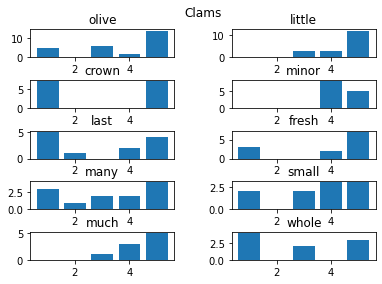

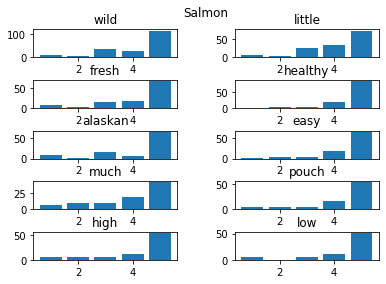

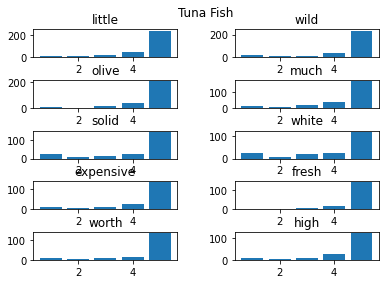

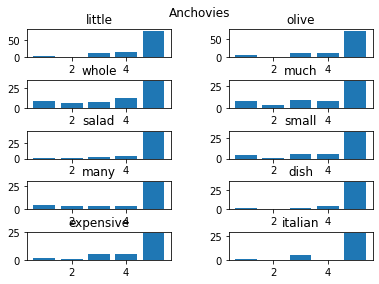

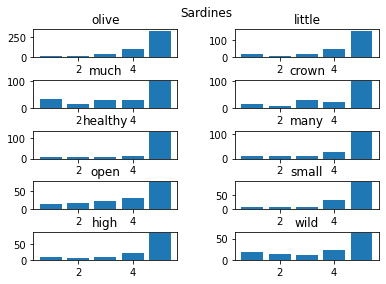

...

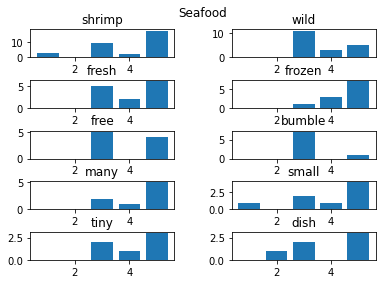

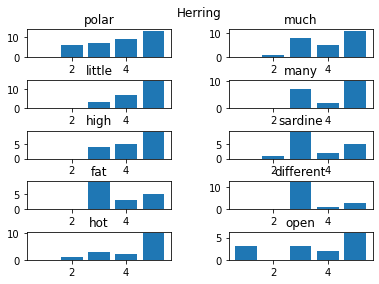

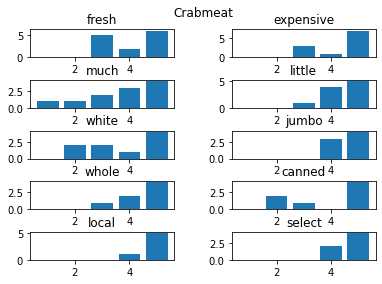

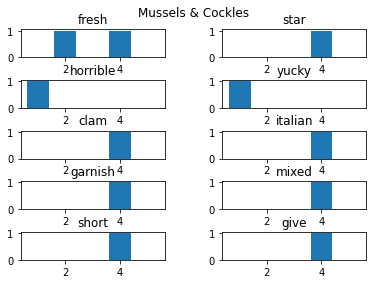

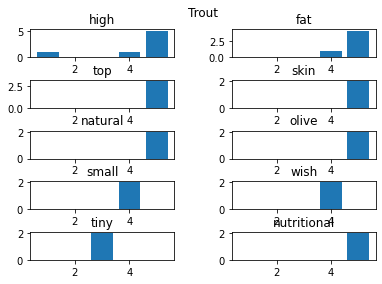

In [22]:
fish_plot(adj_sort)

In [30]:
top_fish = list(vader_amazon['fish'].value_counts()[0:4].keys())
top_fish

['Tuna Fish', 'Sardines', 'Salmon', 'Anchovies']

In [35]:
top_ratings = {}
for fish in adj_sort:
    count = 0
    if fish in top_fish:
        top_ratings[fish] = {}

        for word in adj_sort[fish]:
            
            if adj_sort[fish][word]['total'] >= 10:
                
                top_ratings[fish][word] = adj_sort[fish][word]
                count += 1
        print(fish, count)
top_ratings['Anchovies']

Salmon 132
Tuna Fish 247
Anchovies 69
Sardines 228


{'little': {'total': 113,
  'rating': {1: 5, 2: 1, 3: 12, 4: 17, 5: 78},
  'avg rating': 4.433628318584071},
 'olive': {'total': 104,
  'rating': {1: 6, 2: 1, 3: 12, 4: 12, 5: 73},
  'avg rating': 4.394230769230769},
 'whole': {'total': 68,
  'rating': {1: 9, 2: 6, 3: 8, 4: 12, 5: 33},
  'avg rating': 3.7941176470588234},
 'much': {'total': 58,
  'rating': {1: 8, 2: 3, 3: 9, 4: 8, 5: 30},
  'avg rating': 3.8448275862068964},
 'salad': {'total': 51,
  'rating': {1: 1, 2: 1, 3: 2, 4: 4, 5: 43},
  'avg rating': 4.705882352941177},
 'small': {'total': 47,
  'rating': {1: 4, 2: 1, 3: 5, 4: 5, 5: 32},
  'avg rating': 4.276595744680851},
 'many': {'total': 46,
  'rating': {1: 5, 2: 4, 3: 4, 4: 4, 5: 29},
  'avg rating': 4.043478260869565},
 'dish': {'total': 41,
  'rating': {1: 1, 2: 0, 3: 1, 4: 4, 5: 35},
  'avg rating': 4.7560975609756095},
 'expensive': {'total': 37,
  'rating': {1: 2, 2: 1, 3: 5, 4: 5, 5: 24},
  'avg rating': 4.297297297297297},
 'italian': {'total': 34,
  'rating': {1: 1

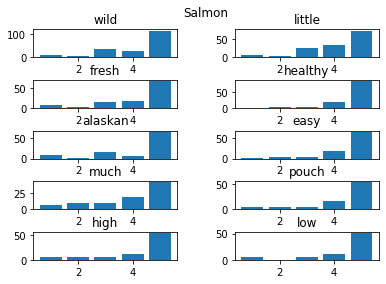

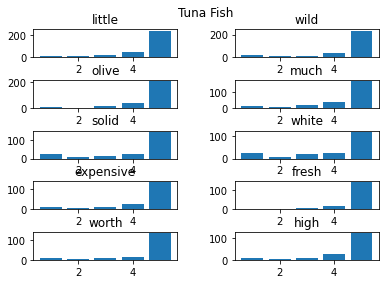

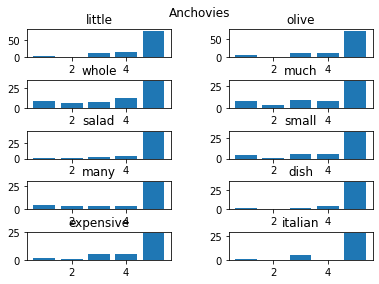

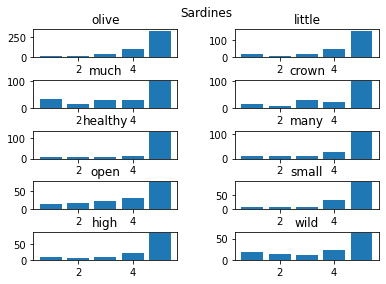

In [36]:
fish_plot(top_ratings)

In [25]:
split_ratings = {}

for fish in adj_sort.keys():
    
    split_ratings[fish] = {}
    
    for word in adj_sort[fish].keys():
        
        if adj_sort[fish][word]['rating'][1] > adj_sort[fish][word]['total']/4 and adj_sort[fish][word]['rating'][5] > adj_sort[fish][word]['total']/4:
            
            split_ratings[fish][word] = adj_sort[fish][word]
split_ratings

{'Clams': {'crown': {'total': 12,
   'rating': {1: 6, 2: 0, 3: 0, 4: 0, 5: 6},
   'avg rating': 3.0},
  'last': {'total': 11,
   'rating': {1: 4, 2: 1, 3: 0, 4: 2, 5: 4},
   'avg rating': 3.090909090909091},
  'local': {'total': 8,
   'rating': {1: 4, 2: 0, 3: 0, 4: 0, 5: 4},
   'avg rating': 3.0},
  'whole': {'total': 8,
   'rating': {1: 3, 2: 0, 3: 2, 4: 0, 5: 3},
   'avg rating': 3.0},
  'snow': {'total': 5,
   'rating': {1: 2, 2: 1, 3: 0, 4: 0, 5: 2},
   'avg rating': 2.8},
  'flavorful': {'total': 3,
   'rating': {1: 1, 2: 0, 3: 0, 4: 1, 5: 1},
   'avg rating': 3.3333333333333335},
  'natural': {'total': 3,
   'rating': {1: 1, 2: 0, 3: 0, 4: 1, 5: 1},
   'avg rating': 3.3333333333333335},
  'full': {'total': 3,
   'rating': {1: 1, 2: 0, 3: 1, 4: 0, 5: 1},
   'avg rating': 3.0},
  'disappointed': {'total': 3,
   'rating': {1: 2, 2: 0, 3: 0, 4: 0, 5: 1},
   'avg rating': 2.3333333333333335},
  'expensive': {'total': 3,
   'rating': {1: 1, 2: 0, 3: 0, 4: 1, 5: 1},
   'avg rating': 3.

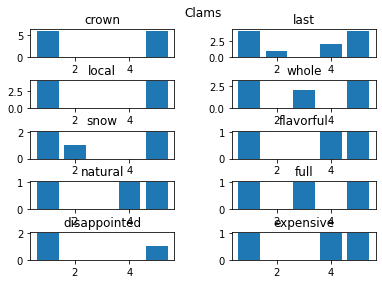

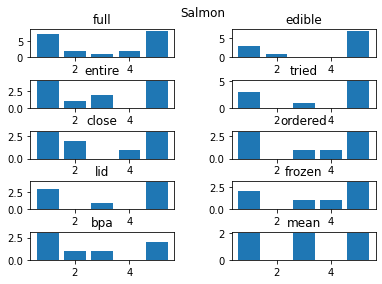

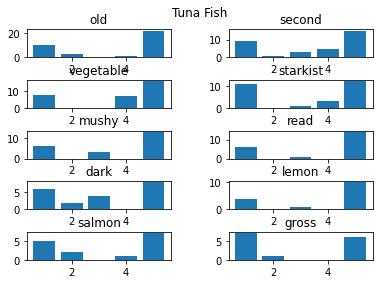

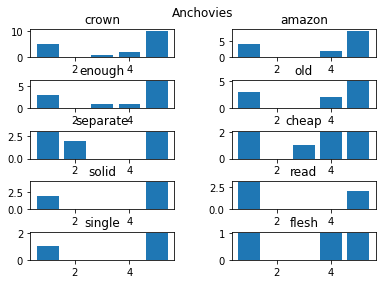

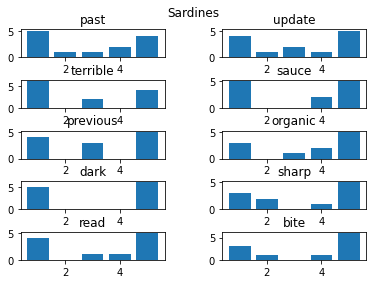

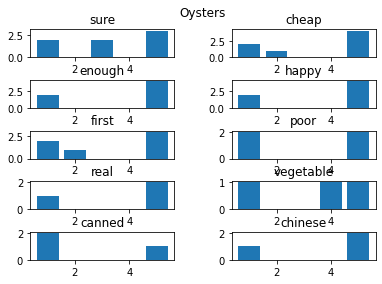

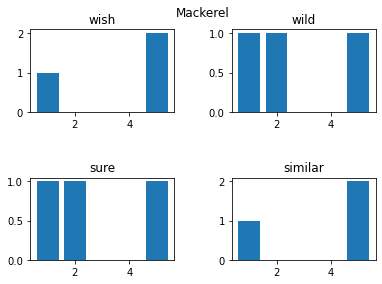

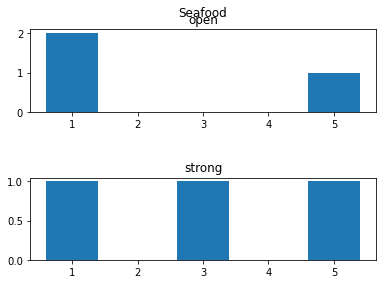

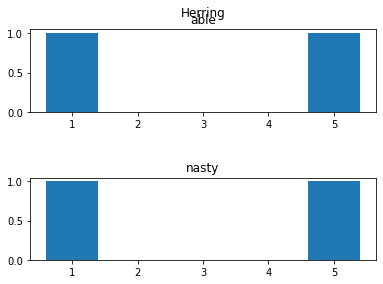

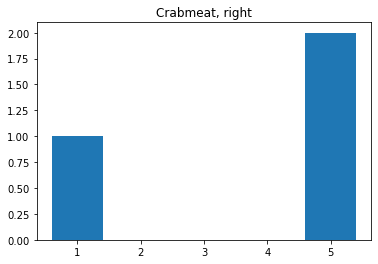

In [26]:
fish_plot(split_ratings)

In [27]:
top_skew_ratings = {}

for fish in adj_sort.keys():
    
    top_skew_ratings[fish] = {}
    
    for word in adj_sort[fish].keys():
        
        if (adj_sort[fish][word]['rating'][4] + adj_sort[fish][word]['rating'][5]) > adj_sort[fish][word]['total']/2 and adj_sort[fish][word]['total'] > 5:
        
            top_skew_ratings[fish][word] = adj_sort[fish][word]
top_skew_ratings

{'Clams': {'olive': {'total': 24,
   'rating': {1: 5, 2: 0, 3: 6, 4: 2, 5: 11},
   'avg rating': 3.5833333333333335},
  'little': {'total': 17,
   'rating': {1: 0, 2: 0, 3: 3, 4: 3, 5: 11},
   'avg rating': 4.470588235294118},
  'last': {'total': 11,
   'rating': {1: 4, 2: 1, 3: 0, 4: 2, 5: 4},
   'avg rating': 3.090909090909091},
  'fresh': {'total': 10,
   'rating': {1: 2, 2: 0, 3: 0, 4: 2, 5: 6},
   'avg rating': 4.0},
  'much': {'total': 9,
   'rating': {1: 0, 2: 0, 3: 1, 4: 3, 5: 5},
   'avg rating': 4.444444444444445},
  'small': {'total': 9,
   'rating': {1: 2, 2: 0, 3: 2, 4: 3, 5: 2},
   'avg rating': 3.3333333333333335},
  'sure': {'total': 8,
   'rating': {1: 1, 2: 0, 3: 1, 4: 2, 5: 4},
   'avg rating': 4.0},
  'minor': {'total': 7,
   'rating': {1: 0, 2: 0, 3: 0, 4: 3, 5: 4},
   'avg rating': 4.571428571428571},
  'new': {'total': 7,
   'rating': {1: 1, 2: 0, 3: 0, 4: 0, 5: 6},
   'avg rating': 4.428571428571429},
  'several': {'total': 7,
   'rating': {1: 1, 2: 1, 3: 0, 4: 

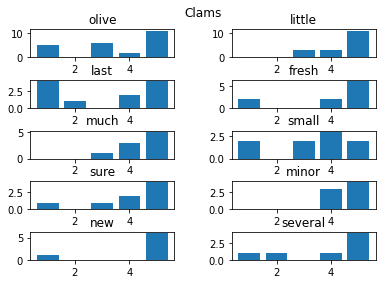

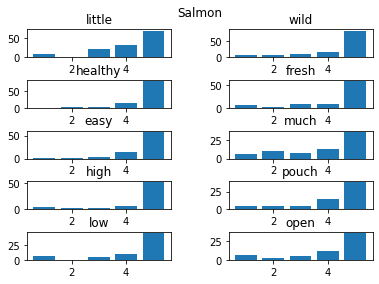

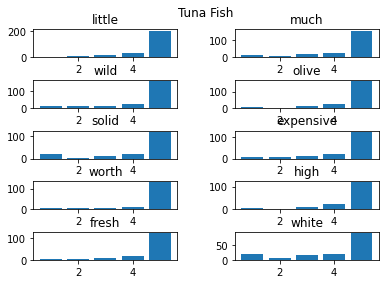

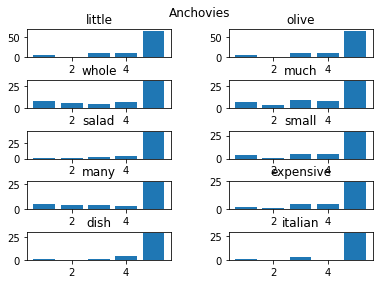

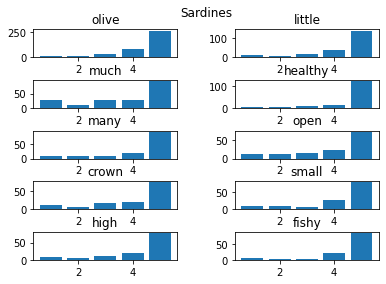

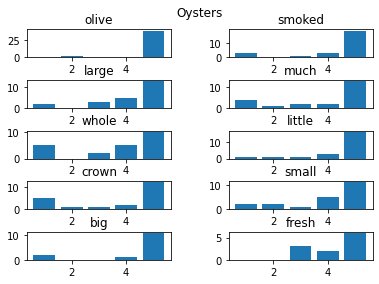

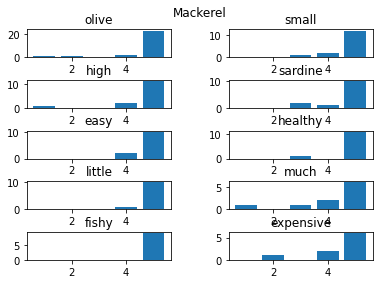

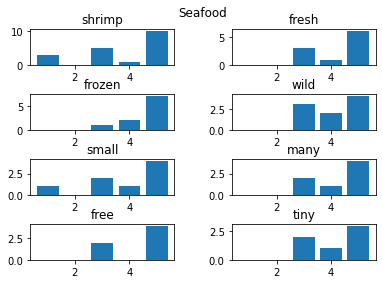

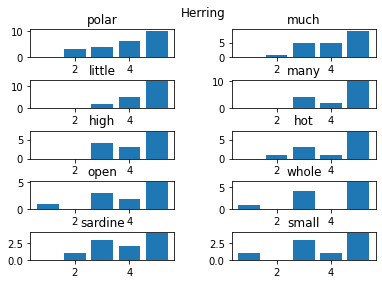

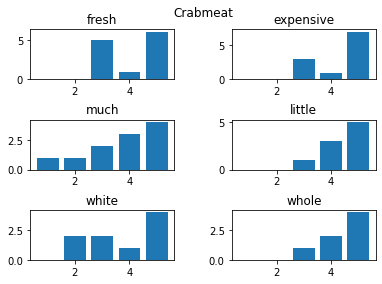

In [29]:
fish_plot(top_skew_ratings)

In [30]:
bottom_skew_ratings = {}

for fish in adj_sort.keys():
    
    bottom_skew_ratings[fish] = {}
    
    for word in adj_sort[fish].keys():
        
        if (adj_sort[fish][word]['rating'][1] + adj_sort[fish][word]['rating'][2]) > adj_sort[fish][word]['total']/2 and adj_sort[fish][word]['total'] > 5:
        
            bottom_skew_ratings[fish][word] = adj_sort[fish][word]
bottom_skew_ratings

{'Clams': {},
 'Salmon': {'awful': {'total': 15,
   'rating': {1: 9, 2: 3, 3: 0, 4: 1, 5: 2},
   'avg rating': 1.9333333333333333},
  'horrible': {'total': 12,
   'rating': {1: 6, 2: 4, 3: 1, 4: 0, 5: 1},
   'avg rating': 1.8333333333333333},
  'close': {'total': 9,
   'rating': {1: 3, 2: 2, 3: 0, 4: 1, 5: 3},
   'avg rating': 2.888888888888889},
  'terrible': {'total': 9,
   'rating': {1: 5, 2: 3, 3: 0, 4: 0, 5: 1},
   'avg rating': 1.7777777777777777},
  'gross': {'total': 8,
   'rating': {1: 6, 2: 2, 3: 0, 4: 0, 5: 0},
   'avg rating': 1.25},
  'inedible': {'total': 7,
   'rating': {1: 6, 2: 0, 3: 1, 4: 0, 5: 0},
   'avg rating': 1.2857142857142858},
  'bpa': {'total': 7,
   'rating': {1: 3, 2: 1, 3: 1, 4: 0, 5: 2},
   'avg rating': 2.5714285714285716}},
 'Tuna Fish': {'inedible': {'total': 15,
   'rating': {1: 7, 2: 3, 3: 1, 4: 2, 5: 2},
   'avg rating': 2.2666666666666666},
  'gross': {'total': 14,
   'rating': {1: 7, 2: 1, 3: 0, 4: 0, 5: 6},
   'avg rating': 2.7857142857142856},


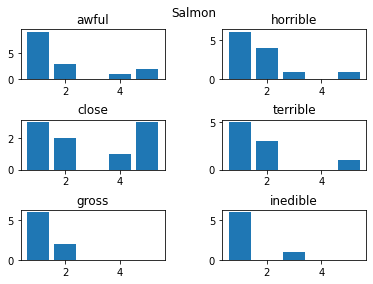

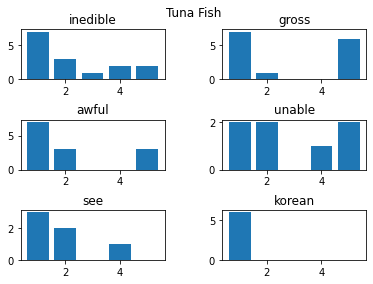

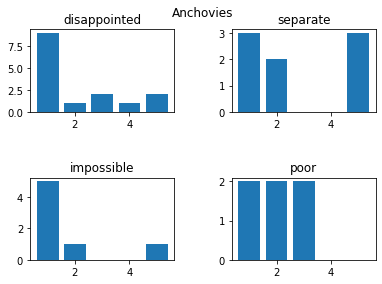

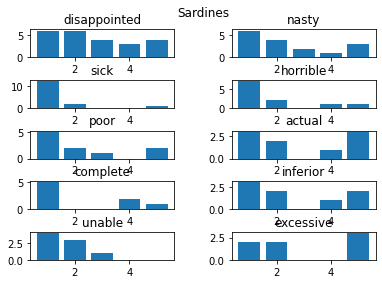

In [31]:
fish_plot(bottom_skew_ratings)

# Lexicological Approach

This section was part of an exploratory experiment into using Lexicological Sentiment Analysis which assigns positive, negative and neutral values to each word based off of set dictionaries. It was determined that this would not be very helpful with the project as many food specific words had completely neutral scores.

In [ ]:
from nltk.sentiment import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')
sia = SentimentIntensityAnalyzer()

In [14]:
example_score = sia.polarity_scores(vader_amazon['description'][0])
example_score

{'neg': 0.008, 'neu': 0.68, 'pos': 0.312, 'compound': 0.995}

In [15]:
vader_amazon['pos'] = ''
vader_amazon['neg'] = ''
vader_amazon['neu'] = ''
vader_amazon['compound'] = ''

for n, row in tqdm(vader_amazon.iterrows(), total = len(vader_amazon)):
    scores = sia.polarity_scores(row['description'])
    vader_amazon['pos'][n] = scores['pos']
    vader_amazon['neg'][n] = scores['neg']
    vader_amazon['neu'][n] = scores['neu']
    vader_amazon['compound'][n] = scores['compound']

vader_amazon

  0%|          | 0/10256 [00:00<?, ?it/s]

C:\Users\wawil\AppData\Local\Temp/ipykernel_37176/1105140284.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vader_amazon['pos'][n] = scores['pos']
C:\Users\wawil\AppData\Local\Temp/ipykernel_37176/1105140284.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vader_amazon['neg'][n] = scores['neg']
C:\Users\wawil\AppData\Local\Temp/ipykernel_37176/1105140284.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vader_amazon['neu'][n

,rating,date,description,asin,fish,name,positive,processed text,pos,neg,neu,compound
0,5,1285632000,Why so excited? Because I have been trying the...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG,1,excited ? trying soupbases minor 's year add d...,0.312,0.008,0.68,0.995
1,4,1131494400,I use it to give many dishes that special some...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG,1,use give many dish special something . prefer ...,0.197,0.0,0.803,0.4019
2,5,1307059200,I just received my order of canned Red Head Wi...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ...",1,received order canned red head wild sockeye sa...,0.299,0.077,0.624,0.8719
3,1,1302825600,Ordered a few cases. It's barely edible. Too s...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ...",0,ordered case . 's barely edible . salty . may ...,0.151,0.254,0.595,-0.7732
4,5,1290124800,I've tried salmon before. Whether it was fres...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ...",1,'ve tried salmon . whether fresh canned . one ...,0.222,0.123,0.655,0.8429
...,...,...,...,...,...,...,...,...,...,...,...,...
10251,5,1517788800,Delicious. Perfect for an on the go lunch. G...,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash...",1,delicious . perfect go lunch . good cracker .,0.774,0.0,0.226,0.8834
10252,5,1517443200,My family love these. The Ranch and Hickory s...,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash...",1,"family love . ranch hickory smoke , fave .",0.64,0.0,0.36,0.7964
10253,1,1517356800,"In general, I love tuna. However, this is the...",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash...",0,"general , love tuna . however , exception . sp...",0.13,0.221,0.649,-0.453
10254,5,1517097600,These are awesome for easy work lunches.,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash...",1,awesome easy work lunch .,0.778,0.0,0.222,0.7906


In [17]:
sent_words = {}

for n, row in vader_amazon.iterrows():
    
    fish = row['fish']
    
    if fish not in sent_words.keys():
        
        sent_words[fish] = {}
        
    review = row['description'].translate(str.maketrans('', '', string.punctuation))
    review_token = word_tokenize(review)
    
    for word in review_token:
        
        if word not in sent_words[fish].keys():
            
            sent_words[fish][word] = ''
sent_words

{'Clams': {'excited': '',
  'trying': '',
  'soupbases': '',
  'minor': '',
  's': '',
  'year': '',
  'add': '',
  'distinguishing': '',
  'taste': '',
  'dish': '',
  'required': '',
  'long': '',
  'ago': '',
  'ventured': '',
  'preparing': '',
  'first': '',
  'official': '',
  'new': '',
  'england': '',
  'clam': '',
  'chowder': '',
  'one': '',
  'cream': '',
  'potato': '',
  'really': '',
  'fine': '',
  'addition': '',
  'like': '',
  'celery': '',
  'red': '',
  'bell': '',
  'pepper': '',
  'finely': '',
  'chopped': '',
  'end': '',
  'result': '',
  'delicious': '',
  'used': '',
  'base': '',
  'several': '',
  'occasion': '',
  'require': '',
  'particular': '',
  'infusion': '',
  'always': '',
  'made': '',
  'look': '',
  'good': '',
  'around': '',
  'dinner': '',
  'table': '',
  'use': '',
  'seafood': '',
  'line': '',
  'since': '',
  'price': '',
  'kind': '',
  'skyrocketed': '',
  'last': '',
  'settle': '',
  'bring': '',
  'best': '',
  'also': '',
  'fis

In [18]:
for fish in sent_words.keys():
    for word in sent_words[fish].keys():
        
        scores = sia.polarity_scores(word)
        sent_words[fish][word] = scores['compound']
sent_words

{'Clams': {'excited': 0.34,
  'trying': 0.0,
  'soupbases': 0.0,
  'minor': 0.0,
  's': 0.0,
  'year': 0.0,
  'add': 0.0,
  'distinguishing': 0.0,
  'taste': 0.0,
  'dish': 0.0,
  'required': 0.0,
  'long': 0.0,
  'ago': 0.0,
  'ventured': 0.0,
  'preparing': 0.0,
  'first': 0.0,
  'official': 0.0,
  'new': 0.0,
  'england': 0.0,
  'clam': 0.0,
  'chowder': 0.0,
  'one': 0.0,
  'cream': 0.0,
  'potato': 0.0,
  'really': 0.0,
  'fine': 0.2023,
  'addition': 0.0,
  'like': 0.3612,
  'celery': 0.0,
  'red': 0.0,
  'bell': 0.0,
  'pepper': 0.0,
  'finely': 0.0,
  'chopped': 0.0,
  'end': 0.0,
  'result': 0.0,
  'delicious': 0.5719,
  'used': 0.0,
  'base': 0.0,
  'several': 0.0,
  'occasion': 0.0,
  'require': 0.0,
  'particular': 0.0,
  'infusion': 0.0,
  'always': 0.0,
  'made': 0.0,
  'look': 0.0,
  'good': 0.4404,
  'around': 0.0,
  'dinner': 0.0,
  'table': 0.0,
  'use': 0.0,
  'seafood': 0.0,
  'line': 0.0,
  'since': 0.0,
  'price': 0.0,
  'kind': 0.5267,
  'skyrocketed': 0.0,
  'la

In [19]:
sorted_words = {}

for fish in fish_list:
    sorted_words[fish] = OrderedDict(sorted(sent_words[fish].items(), key =lambda x:x[1], reverse=True))
sorted_words

{'Clams': OrderedDict([('best', 0.6369),
              ('love', 0.6369),
              ('perfectly', 0.6369),
              ('great', 0.6249),
              ('superb', 0.6249),
              ('awesome', 0.6249),
              ('outstanding', 0.6124),
              ('loving', 0.5994),
              ('loved', 0.5994),
              ('delight', 0.5994),
              ('joy', 0.5859),
              ('delightful', 0.5859),
              ('amazing', 0.5859),
              ('lover', 0.5859),
              ('delicious', 0.5719),
              ('pleasure', 0.5719),
              ('excellent', 0.5719),
              ('wonderful', 0.5719),
              ('perfect', 0.5719),
              ('happy', 0.5719),
              ('rich', 0.5574),
              ('fantastic', 0.5574),
              ('bonus', 0.5423),
              ('kind', 0.5267),
              ('justice', 0.5267),
              ('richer', 0.5267),
              ('yummy', 0.5267),
              ('fabulous', 0.5267),
              ('free', 

# Deep Learning

So we turned to using Deep Learning Models to conduct the Sentiment Analysis

In [37]:
"""Sorting the reviews from largest to smallest since the token tensors for the reviews must be of equal size
for the deep learning model. The token tensors include an attention mask which tells the model whether or not to ignore an entry
so the empty space in smaller reviews is not an issue."""

sort = vader_amazon.description.str.len().sort_values().index
amazon_sort = vader_amazon.reindex(sort)
amazon_sort.sort_index(inplace=True, ascending=True)
amazon_sort

,rating,date,description,asin,fish,name
0,5.0,1285632000,excited ? trying soupbases minor 's year add d...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
1,4.0,1131494400,use give many dish special something . prefer ...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG
2,5.0,1307059200,received order canned red head wild sockeye sa...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
3,1.0,1302825600,ordered case . 's barely edible . salty . may ...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
4,5.0,1290124800,'ve tried salmon . whether fresh canned . one ...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ..."
...,...,...,...,...,...,...
10251,5.0,1517788800,delicious . perfect go lunch . good cracker .,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10252,5.0,1517443200,"family love . ranch hickory smoke , fave .",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10253,1.0,1517356800,"general , love tuna . however , exception . sp...",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."
10254,5.0,1517097600,awesome easy work lunch .,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash..."


In [38]:
# Loading in the Deep Learning model directly
from transformers import AutoTokenizer, AutoModelForSequenceClassification

tokenizer_LiYuan = AutoTokenizer.from_pretrained("LiYuan/amazon-review-sentiment-analysis")
model_LiYuan = AutoModelForSequenceClassification.from_pretrained("LiYuan/amazon-review-sentiment-analysis")

In [39]:
#Sigmoid function for normalizing the scores
def sig(x):
        
    x_list = []

    for n in range(len(x)):

        x_list.append(1/(1 + np.exp(-x[n])))
        
    return x_list

In [40]:
"""This turns each block of text into a token tensor and runs it through the model to return the confidence score 
for each star rating. These scores indicate how strongly the model feels that the review was rated with the corresponding number
of stars. It also applies the sigmoid to constrain the scores between 0 and 1."""

def sentiment_star(model, tokenizer, review):
    example_text = tokenizer(review, return_tensors='pt', padding=True, truncation=True)
    output = model(**example_text)
    scores = output[0][0].detach().numpy()
    scores = sig(scores)
    return scores

def sentiment_from_token_star(model, token):
    output = model(**token)
    scores = output[0][0].detach().numpy()
    scores = sig(scores)
    return scores

In [41]:
#Finding the overall sentiment for each review and storing the scores
amazon_star = amazon_sort.copy()
for i in range(1,6):
    amazon_star[f"{i}"] = ''

for n, row in tqdm(amazon_star.iterrows(), total = len(amazon_star)):
    scores = sentiment_star(model_LiYuan, tokenizer_LiYuan, row['description'])
    
    for j in range(len(scores)):
        
        amazon_star[f'{j+1}'][n] = scores[j]

  0%|          | 0/10256 [00:00<?, ?it/s]

C:\Users\wawil\AppData\Local\Temp/ipykernel_13788/3339194986.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  amazon_star[f'{j+1}'][n] = scores[j]


In [13]:
amazon_star['Projected Rating'] = ''
amazon_star['Rating Difference'] = ''

#Finding the predicted rating for each review using the confidence scores
for n, row in amazon_star.iterrows():
    prediction = 0
    scores = []
    scores_sum = 0
    for m in range(0,5):
        scores.append(row[f'{m+1}'])
    
    #Finding the sum of the confidence scores to normalize them to add up to 1
    scores_sum = sum(scores)
    
    #Predicting the score with a weighted sum. The normalized confidence score for each star rating is multiplied by the
    #corresponding integer and they're all summed. It is also rounded to 2 decimal precision.
    
    prediction = round(sum([(n*scores[n-1])/scores_sum for n in range(1,6)]), 2)
    
    amazon_star['Projected Rating'][n] = prediction
    
    #Finding the difference between the predicted values and the actual values for the ratings
    amazon_star['Rating Difference'][n] = prediction - row['rating']
amazon_star

C:\Users\wawil\AppData\Local\Temp/ipykernel_24492/2419791716.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  amazon_star['Projected Rating'][n] = prediction
C:\Users\wawil\AppData\Local\Temp/ipykernel_24492/2419791716.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  amazon_star['Rating Difference'][n] = prediction - row['rating']


,rating,date,description,asin,fish,name,1,2,3,4,5,Projected Rating,Rating Difference
index,,,,,,,,,,,,,
0,5.0,1285632000,excited ? trying soupbases minor 's year add d...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG,0.264432,0.194907,0.248043,0.653077,0.914084,3.77,-1.23
1,4.0,1131494400,use give many dish special something . prefer ...,B0001GUQ3O,Clams,Minor&rsquo;s Clam Base - no-added MSG,0.124027,0.179914,0.490421,0.784853,0.865765,3.85,-0.15
2,5.0,1307059200,received order canned red head wild sockeye sa...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ...",0.084473,0.054146,0.147095,0.830790,0.988117,4.23,-0.77
3,1.0,1302825600,ordered case . 's barely edible . salty . may ...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ...",0.953491,0.596864,0.263649,0.160931,0.427987,2.38,1.38
4,5.0,1290124800,'ve tried salmon . whether fresh canned . one ...,B0006UFY46,Salmon,"Redhead Wild Sockeye Salmon From Alaska, (12) ...",0.170673,0.120763,0.218577,0.745294,0.959126,3.99,-1.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10251,5.0,1517788800,delicious . perfect go lunch . good cracker .,B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash...",0.060370,0.048582,0.124765,0.862292,0.991439,4.28,-0.72
10252,5.0,1517443200,"family love . ranch hickory smoke , fave .",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash...",0.104719,0.086822,0.278482,0.808080,0.963048,4.09,-0.91
10253,1.0,1517356800,"general , love tuna . however , exception . sp...",B00DYGQINK,Tuna Fish,"StarKist Tuna Creations, Hickory Smoked &ndash...",0.744438,0.567323,0.493894,0.353453,0.420174,2.67,1.67


In [14]:
#Saving the csv so that it is not necessary to run everything again.
amazon_star.index.name = 'index'
amazon_star.to_csv(df/'amazon_star.csv')

In [41]:
amazon_star = pd.read_csv(df/'amazon_star.csv', index_col=0)

In [42]:
#Going through the list of previously identified descriptive words and getting their token ids to search through the reviews
for fish in top_ratings:
    words = top_ratings[fish]

    for word in words:

        token_id = tokenizer_LiYuan(word)
        top_ratings[fish][word]['input_ids'] = token_id['input_ids'][1:-1]

In [43]:
#Tests if one list is contained within another in order and without entries in between members of the first list

def is_slice_in_list(s,l):
    len_s = len(s)
    return any(s == l[i:len_s+i] for i in range(len(l) - len_s+1))

In [45]:
top_ratings_ids = deepcopy(top_ratings)

"""The tokenizer can assign token ids to words which contain the token ids for other words. This is an issue because for
multi-word strings, the tokenizer does not assign spaces a token. This cell identifies all instances in the reviews where
one of the selected words in our list has token ids which are contained within another's and identifies the tokens before
and after the selected word's token ids to flag it as an occurance of a 'compound token list' in subsequent code so those
instances can be ignored."""

#Iterating through each review
for n, row in tqdm(amazon_star.iterrows(), total = len(amazon_star)):
    
    fish = row['fish']
    if fish in top_fish:
        words = top_ratings_ids[fish]
        review = row['description']

        #Splitting each review's tokens by word
        split_id = tokenizer_LiYuan(review.split(), return_tensors='pt', padding=True, truncation=True)['input_ids'][0].tolist()

        #Counting the number of padded cells at the end of the tokens to remove
        pad = split_id.count(0)

        for x in range(pad):
            split_id.remove(0)

        #Iterating through each selected word
        for word in words:

            if 'comp_ids' not in top_ratings_ids[fish][word].keys():
                top_ratings_ids[fish][word]['comp_ids'] = []

            #Testing each word to see if it is in each review. If it is, it identifies if there are tokens before or after the token
            #for the word. If there are, it stores the compound id and the index value of the id for the selected word
            if (
                is_slice_in_list(top_ratings_ids[fish][word]['input_ids'], split_id[1:-1]) 
                and len(split_id[1:-1]) > len(top_ratings_ids[fish][word]['input_ids'])
                and list([split_id[1:-1], split_id[1:-1].index(top_ratings_ids[fish][word]['input_ids'][0])]) not in top_ratings_ids[fish][word]['comp_ids']
               ):

                top_ratings_ids[fish][word]['comp_ids'].append([split_id[1:-1], split_id[1:-1].index(top_ratings_ids[fish][word]['input_ids'][0])])
top_ratings_ids

  0%|          | 0/10256 [00:00<?, ?it/s]

{'Salmon': {'wild': {'total': 199,
   'rating': {1: 10, 2: 8, 3: 38, 4: 29, 5: 114},
   'avg rating': 4.150753768844221,
   'input_ids': [14647],
   'comp_ids': [[[14647, 118, 34576], 0]]},
  'little': {'total': 145,
   'rating': {1: 8, 2: 3, 3: 26, 4: 35, 5: 73},
   'avg rating': 4.117241379310345,
   'input_ids': [11975],
   'comp_ids': []},
  'fresh': {'total': 111,
   'rating': {1: 8, 2: 3, 3: 15, 4: 18, 5: 67},
   'avg rating': 4.198198198198198,
   'input_ids': [31522],
   'comp_ids': []},
  'healthy': {'total': 109,
   'rating': {1: 1, 2: 2, 3: 4, 4: 19, 5: 83},
   'avg rating': 4.660550458715596,
   'input_ids': [66408],
   'comp_ids': []},
  'alaskan': {'total': 98,
   'rating': {1: 9, 2: 2, 3: 17, 4: 6, 5: 64},
   'avg rating': 4.163265306122449,
   'input_ids': [19378, 10115],
   'comp_ids': []},
  'easy': {'total': 91,
   'rating': {1: 2, 2: 4, 3: 3, 4: 18, 5: 64},
   'avg rating': 4.516483516483516,
   'input_ids': [24806],
   'comp_ids': []},
  'much': {'total': 86,
   'r

In [46]:
top_ratings_var = deepcopy(top_ratings_ids)


#Now we run the sentiment analysis on the reviews again but this time, we identify each occurance of the selected words
#and run it with each of those instances removed one by one. The difference of the scores from the original is recorded
for i, row in tqdm(amazon_star.iterrows(), total = len(amazon_star)):
    num = 0    
    fish = row['fish']
    if fish in top_fish:
        words = top_ratings_var[fish]
        review = tokenizer_LiYuan(row['description'], return_tensors='pt', padding=True, truncation=True)
        review_ids = review['input_ids'][0].tolist()

        for n in range(len(review_ids)):

            for word in words:

                skip = 0

                if 'variance' not in words[word].keys():

                    words[word]['variance'] = {}
                    for j in range(1,6):
                        words[word]['variance'][j] = []
                    words[word]['variance']['date'] = []


                #Testing for occurences of each selected word
                if words[word]['input_ids'] == review_ids[n:len(words[word]['input_ids'])+n]:

                    for m in range(len(words[word]['comp_ids'])):

                        #Testing if the tokens occur in a compound id and skipping if they do
                        if (words[word]['comp_ids'][m][0] == 
                            review_ids[n-words[word]['comp_ids'][m][1]:len(words[word]['comp_ids'][m][0])+n-words[word]['comp_ids'][m][1]]):

                            skip = 1
                            break
                    if skip == 1:

                        print('Compound word', words[word]['comp_ids'][m][0])

                    #If one of the selected words is found in the review, the attention mask at those id positions is set to 0
                    #This tells the model to ignore those tokens.
                    else:

                        var_review = deepcopy(review)
                        var_review_ids = var_review['input_ids']
                        var_review_mask = var_review['attention_mask']

                        for x in range(len(words[word]['input_ids'])):
                            var_review_mask[0][n+x] = 0

                        output = model_LiYuan(**var_review)
                        scores = output[0][0].detach().numpy()
                        scores = sig(scores)

                        #Once the scores are found, the difference from the original is stored as well as the date for the review
                        for j in range(1,6):

                            words[word]['variance'][j].append(row[f'{j}']-scores[j-1])

                        words[word]['variance']['date'].append(row['date'])

                        del var_review, var_review_ids, var_review_mask

  0%|          | 0/10256 [00:00<?, ?it/s]

Compound word [14647, 118, 34576]
Compound word [10452, 19066]
Compound word [19378, 10115]
Compound word [19378, 10115]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [39999, 10142]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [19378, 10115]
Compound word [10452, 19066]
Compound word [19378, 10115]
Compound word [39999, 10142]
Compound word [19378, 10115]
Compound word [39999, 10142]
Compound word [10452, 19066]
Compound word [11531, 10163]
Compound word [35665, 14324]
Compound word [39999, 10142]
Compound word [19378, 10115]
Compound word [19378, 10115]
Compound word [11531, 10163]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [10452, 19066]
Compound word [19378, 10115]
Compound word [10452, 19066]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound 

Compound word [28106, 15470]
Compound word [20474, 10158]
Compound word [39999, 10142]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [39999, 10142]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [16222, 10563]
Compound word [78026, 10177]
Compound word [78026, 10177]
Compound word [78026, 10177]
Compound word [11531, 10163]
Compound word [78026, 10177]
Compound word [11531, 10163]
Compound word [78026, 10177]
Compound word [20474, 10158]
Compound word [25840, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [25840, 10158]
Compound word [39999, 10142]
Compound word [39999, 10142]
Compound word [11531, 10163]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [39999, 10142]
Compound word [11531, 10163]
Compound word [28106, 15470]
Compound word 

Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [39999, 10142]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [11531, 10163]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [11053, 118, 19468]
Compound word [11531, 10163]
Compound word [20474, 10158]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [78026, 10177]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound 

Compound word [28106, 15470]
Compound word [78026, 10177]
Compound word [39999, 10142]
Compound word [61530, 10285]
Compound word [78026, 10177]
Compound word [68763, 36636, 118, 12487]
Compound word [10920, 48899, 68806]
Compound word [78026, 10177]
Compound word [20474, 10158]
Compound word [39999, 10142]
Compound word [78026, 10177]
Compound word [10920, 48899, 68806]
Compound word [10920, 48899, 68806]
Compound word [39999, 10142]
Compound word [20474, 10158]
Compound word [78026, 10177]
Compound word [11531, 10163]
Compound word [11531, 10163]
Compound word [10920, 48899, 68806]
Compound word [39999, 10142]
Compound word [16612, 10285]
Compound word [11053, 118, 19468]
Compound word [11053, 118, 19468]
Compound word [11531, 10163]
Compound word [20474, 10158]
Compound word [78026, 10177]
Compound word [78026, 10177]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 

Compound word [20474, 10158]
Compound word [39999, 10142]
Compound word [39999, 10142]
Compound word [19378, 10115]
Compound word [19378, 10115]
Compound word [39999, 10142]
Compound word [33989, 11183, 11894]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [39999, 10142]
Compound word [11053, 118, 19468]
Compound word [39999, 10142]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [11531, 10163]
Compound word [11531, 10163]
Compound word [20474, 10158]
Compound word [39999, 10142]
Compound word [20474, 10158]
Compound word [20474, 10158]
Compound word [28106, 15470]
Compound word [11531, 10163]
Compound word [28106, 15470]
Compound word [11531, 10163]
Compound word [39999, 10142]
Compound word [20474, 10158]
Compound word [39999, 10142]
Compound word [11531, 10131]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [28106, 15470]
Compound word [20895, 120, 16399]
Compound word [20895, 120,

In [47]:
#Saving the data so that the model doesn't have to be rerun each time to save on computation time
with open("Resources/top_ratings_var.pkl", "wb") as fp:
    pickle.dump(top_ratings_var, fp)

In [48]:
with open('Resources/top_ratings_var.pkl', 'rb') as fp:
    top_ratings_var = pickle.load(fp)

In [49]:
top_ratings_var

{'Salmon': {'wild': {'total': 199,
   'rating': {1: 10, 2: 8, 3: 38, 4: 29, 5: 114},
   'avg rating': 4.150753768844221,
   'input_ids': [14647],
   'comp_ids': [[[14647, 118, 34576], 0]],
   'variance': {1: [-0.0009722618179777986,
     -0.00022598598396145197,
     1.9602606777108234e-05,
     0.0016078377763021068,
     0.0009524995154022928,
     -0.005202737678128427,
     0.003624871520189865,
     -0.0161614134829709,
     0.006681625681167036,
     -0.02033679759138507,
     -0.00510161711019709,
     0.007268344958523104,
     -0.0016289014158615556,
     -0.027904875317870254,
     -0.001786897717975619,
     0.0002317398288551875,
     0.005556286589794818,
     2.7958166098823733e-05,
     -0.00022324457593700386,
     3.638892913127023e-05,
     0.000302512731007315,
     0.0001775570289122147,
     0.007538608366587998,
     0.00044623056420287077,
     0.001345698542937937,
     -0.0048234380696811074,
     0.0003585005489749604,
     -0.0007877261853589945,
     0.00037

In [50]:
#Converting to a pandas dataframe to export to a csv
df_var_data = {'Fish': [],
           'Word': [],
           'Review Date' : [],
           'Star' : [],
           'Star Variance' : []
          }
    
for fish in top_ratings_var:
    words = top_ratings_var[fish]
    
    for word in words:
        
        variance = words[word]['variance']
        
        for i in range(len(variance[1])):
            
            for j in range(1,6):
                df_var_data['Fish'].append(fish)
                df_var_data['Word'].append(word)
                df_var_data['Review Date'].append(variance['date'][i])
                df_var_data['Star'].append(j)
                df_var_data['Star Variance'].append(variance[j][i])
            
df_var_data

{'Fish': ['Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmon',
  'Salmo

In [51]:
word_var_df = pd.DataFrame.from_dict(df_var_data)
word_var_df.index.name = 'index'
word_var_df.to_csv(df/'word_var_df.csv')
word_var_df

,Fish,Word,Review Date,Star,Star Variance
index,,,,,
0,Salmon,wild,1307059200,1,-0.000972
1,Salmon,wild,1307059200,2,-0.000156
2,Salmon,wild,1307059200,3,0.000384
3,Salmon,wild,1307059200,4,0.001337
4,Salmon,wild,1307059200,5,0.000010
...,...,...,...,...,...
237815,Sardines,ready,1398988800,1,0.000223
237816,Sardines,ready,1398988800,2,0.000027
237817,Sardines,ready,1398988800,3,-0.000065


In [52]:
top_ratings_avg = deepcopy(top_ratings_var)

#A new dictionary with the average changes of the scores for each word.

for fish in top_ratings_avg:
    
    words = top_ratings_avg[fish]
    
    for word in list(words):
        
        skip = 0
        
        variance = words[word]['variance']
        variance.pop('date', None)
        for star in variance:
            
            if len(variance[star]) != 0:
                
                variance[star] = sum(variance[star])/len(variance[star])
                
            elif len(variance[star]) == 0:
                
                skip = 1
                break
                
        if skip == 1:
            top_ratings_avg[fish].pop(word, None)
        
top_ratings_avg

{'Salmon': {'wild': {'total': 199,
   'rating': {1: 10, 2: 8, 3: 38, 4: 29, 5: 114},
   'avg rating': 4.150753768844221,
   'input_ids': [14647],
   'comp_ids': [[[14647, 118, 34576], 0]],
   'variance': {1: -0.001348950632636072,
    2: -0.0016097598516288112,
    3: -0.0017889364681438606,
    4: 0.0011375304573865291,
    5: 0.0020234066474733863}},
  'little': {'total': 145,
   'rating': {1: 8, 2: 3, 3: 26, 4: 35, 5: 73},
   'avg rating': 4.117241379310345,
   'input_ids': [11975],
   'comp_ids': [],
   'variance': {1: -0.0025088107153672396,
    2: 0.005460271294891067,
    3: 0.01633409297127089,
    4: 0.0021023710859061386,
    5: -0.009103552187950979}},
  'fresh': {'total': 111,
   'rating': {1: 8, 2: 3, 3: 15, 4: 18, 5: 67},
   'avg rating': 4.198198198198198,
   'input_ids': [31522],
   'comp_ids': [],
   'variance': {1: -0.0038422726207317376,
    2: -0.0034734699893437756,
    3: -0.0039513311763644775,
    4: 0.003211669510631945,
    5: 0.004138400452429414}},
  'health

In [53]:
#Converting to a pandas dataframe to export to a csv
df_avg_data = {'Fish': [],
           'Word': [],
           'Average Rating': [],
           'Star': [],
           'Star Rating Count': [],
           'Star Variance': []
          }


for fish in top_ratings_avg:
    
    words = top_ratings_avg[fish]
    
    for word in words:
        
        variance = words[word]['variance']
        
        for n in range(1,6):
            df_avg_data['Fish'].append(fish)
            df_avg_data['Word'].append(word)
            df_avg_data['Average Rating'].append(words[word]['avg rating'])
            
            df_avg_data['Star'].append(n)
            df_avg_data['Star Rating Count'].append(words[word]['rating'][n])
            df_avg_data['Star Variance'].append(variance[n])

In [54]:
word_avg_df = pd.DataFrame.from_dict(df_avg_data)
word_avg_df.index.name = 'index'
word_avg_df.to_csv(df/'word_avg_df.csv')
word_avg_df

,Fish,Word,Average Rating,Star,Star Rating Count,Star Variance
index,,,,,,
0,Salmon,wild,4.150754,1,10,-0.001349
1,Salmon,wild,4.150754,2,8,-0.001610
2,Salmon,wild,4.150754,3,38,-0.001789
3,Salmon,wild,4.150754,4,29,0.001138
4,Salmon,wild,4.150754,5,114,0.002023
...,...,...,...,...,...,...
3365,Sardines,ready,3.900000,1,1,-0.007184
3366,Sardines,ready,3.900000,2,1,-0.005400
3367,Sardines,ready,3.900000,3,1,-0.003482


# Plots
Some exploratory plots

In [73]:
avg_diff = []

for n in range(0, 5):

    avg_diff.append(amazon_star.loc[amazon_star['rating'] == n+1]['Rating Difference'].tolist())
    avg_diff[n] = sum(avg_diff[n])/len(avg_diff[n])
avg_diff

[1.7651298175760455,
 1.0260106968997942,
 0.4079177494302565,
 -0.16388999859699396,
 -0.9760770410087947]

In [15]:
amazon_star_trim = amazon_star.copy()
amazon_star_trim.drop(columns=['description', 'name'], inplace=True)
amazon_star_trim.to_csv(df/'amazon_star_trim.csv')

In [16]:
amazon_star_trim

,rating,date,asin,fish,1,2,3,4,5,Projected Rating,Rating Difference
index,,,,,,,,,,,
0,5.0,1285632000,B0001GUQ3O,Clams,0.264432,0.194907,0.248043,0.653077,0.914084,3.77,-1.23
1,4.0,1131494400,B0001GUQ3O,Clams,0.124027,0.179914,0.490421,0.784853,0.865765,3.85,-0.15
2,5.0,1307059200,B0006UFY46,Salmon,0.084473,0.054146,0.147095,0.830790,0.988117,4.23,-0.77
3,1.0,1302825600,B0006UFY46,Salmon,0.953491,0.596864,0.263649,0.160931,0.427987,2.38,1.38
4,5.0,1290124800,B0006UFY46,Salmon,0.170673,0.120763,0.218577,0.745294,0.959126,3.99,-1.01
...,...,...,...,...,...,...,...,...,...,...,...
10251,5.0,1517788800,B00DYGQINK,Tuna Fish,0.060370,0.048582,0.124765,0.862292,0.991439,4.28,-0.72
10252,5.0,1517443200,B00DYGQINK,Tuna Fish,0.104719,0.086822,0.278482,0.808080,0.963048,4.09,-0.91
10253,1.0,1517356800,B00DYGQINK,Tuna Fish,0.744438,0.567323,0.493894,0.353453,0.420174,2.67,1.67


In [75]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=amazon_star['rating'], name= 'Actual Rating', yaxis='y'))
fig.add_trace(go.Histogram(x=amazon_star['Projected Rating'], name= 'Projected Rating', yaxis='y'))
fig.add_trace(go.Line(x = list(range(1,6)), y = avg_diff, yaxis = 'y2'))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.75)
fig.update_layout(title_text = 'Actual vs Projected Ratings')

fig.update_layout({
        'yaxis': {'title': 'Histogram Count', 'tickmode':'sync'},
        'yaxis2': {'title': 'Projection Error', 'overlaying': 'y', 'side': 'right', 'range':[-1, 2]},
    })
fig.show()

C:\Users\wawil\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [76]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=amazon_star['Rating Difference'], name= 'Rating Difference', yaxis='y'))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.75)
fig.update_layout(title_text = 'Rating Difference')

fig.show()

In [77]:
fish = 'Tuna Fish'

fig = go.Figure()
num = 10

for n in range(num):
    if n == 0:
        visible = True
    else:
        visible = False
        
    word = list(top_ratings_avg[fish].keys())[n]
    fig.add_trace(go.Bar(name='Word Distribution', x= list(top_ratings_avg[fish][word]['rating'].keys()), 
                y= list(top_ratings_avg[fish][word]['rating'].values()), yaxis='y', offsetgroup=1, visible=visible))
    fig.add_trace(go.Bar(name = 'Average Sentiment Effect', x = list(top_ratings_avg[fish][word]['variance'].keys()),
                y = list(top_ratings_avg[fish][word]['variance'].values()), yaxis='y2', offsetgroup=2, visible=visible))

range_dist = max(fig.data[0]['y'])
range_sent = max([abs(max(fig.data[1]['y'])),
                 abs(min(fig.data[1]['y']))])
fig.update_layout({
        'yaxis': {'title': 'Count', 'range': [-range_dist - range_dist/10, range_dist + range_dist/10]},
        'yaxis2': {'title': 'Average Sentiment Strength', 'overlaying': 'y', 'side': 'right', 'tickmode':'sync'
                   ,'range': [-range_sent- range_sent/10, range_sent + range_sent/10]},
    })
# Change the bar mode
fig.update_layout(barmode='group')

update= dict(active = 0, buttons = [])
n = 0
for words in list(top_ratings_avg[fish].keys())[0:num]:
    visible = [False for i in range((2*num)+1)]
    visible[2*n] = True
    visible[(2*n)+1] = True
    range_dist = max(list(top_ratings_avg[fish][words]['rating'].values()))
    range_sent = max([abs(max(top_ratings_avg[fish][words]['variance'].values())),
                 abs(min(top_ratings_avg[fish][words]['variance'].values()))])
    update['buttons'].append(dict(
        label = words,
        method = "update",
        args = [
            {
                'visible': visible,
            },
            {'title': f'{fish}, {words}', 'yaxis': {'title': 'Count axis', 'range': [-range_dist - range_dist/10, range_dist + range_dist/10]},
        'yaxis2': {'title': 'Sentiment axis', 'overlaying': 'y', 'side': 'right', 'tickmode':'sync'
                   ,'range': [-range_sent- range_sent/10, range_sent + range_sent/10]}}
        ]))
    n +=1
fig.update_layout(updatemenus = [update])
fig.update_layout(title_text = f'{fish}, {list(top_ratings_avg[fish].keys())[0]}')

fig.show()

In [78]:
len(top_ratings_avg['Tuna Fish'].keys())

1315

In [79]:
def fish_comp(fish, limit = 0):
    
    fig = go.Figure()
    
    if limit == 0 or limit > len(top_ratings_avg[fish].keys()):
        num = len(top_ratings_avg[fish].keys())
    else:
        num = limit

    for n in range(num):
        if n == 0:
            visible = True
        else:
            visible = False

        word = list(top_ratings_avg[fish].keys())[n]
        fig.add_trace(go.Bar(name='Word Distribution', x= list(top_ratings_avg[fish][word]['rating'].keys()), 
                    y= list(top_ratings_avg[fish][word]['rating'].values()), yaxis='y', offsetgroup=1, visible=visible))
        fig.add_trace(go.Bar(name = 'Average Sentiment Effect', x = list(top_ratings_avg[fish][word]['variance'].keys()),
                    y = list(top_ratings_avg[fish][word]['variance'].values()), yaxis='y2', offsetgroup=2, visible=visible))

    range_dist = max(fig.data[0]['y'])
    range_sent = max([abs(max(fig.data[1]['y'])),
                     abs(min(fig.data[1]['y']))])
    fig.update_layout({
            'yaxis': {'title': 'Count', 'range': [-range_dist - range_dist/10, range_dist + range_dist/10]},
            'yaxis2': {'title': 'Sentiment Strength', 'overlaying': 'y', 'side': 'right', 'tickmode':'sync',
                       'range': [-range_sent- range_sent/10, range_sent + range_sent/10]},
        })
    # Change the bar mode
    fig.update_layout(barmode='group')

    update= dict(active = 0, buttons = [])
    n = 0
    for words in list(top_ratings_avg[fish].keys())[0:num]:
        visible = [False for i in range((2*num)+1)]
        visible[2*n] = True
        visible[(2*n)+1] = True
        range_dist = max(list(top_ratings_avg[fish][words]['rating'].values()))
        range_sent = max([abs(max(top_ratings_avg[fish][words]['variance'].values())),
                     abs(min(top_ratings_avg[fish][words]['variance'].values()))])
        update['buttons'].append(dict(
            label = words.capitalize(),
            method = "update",
            args = [
                {
                    'visible': visible,
                },
                {'title': f'{fish}, Keyword: {words.capitalize()}', 'yaxis': {'title': 'Count axis', 'range': [-range_dist - range_dist/10, range_dist + range_dist/10]},
            'yaxis2': {'title': 'Sentiment axis', 'overlaying': 'y', 'side': 'right', 'tickmode':'sync',
                       'range': [-range_sent- range_sent/10, range_sent + range_sent/10]}}
            ]))
        n +=1
    fig.update_layout(updatemenus = [update])
    fig.update_layout(title_text = f'{fish}, Keyword: {list(top_ratings_avg[fish].keys())[0].capitalize()}')

    fig.show()
    
    return fig

In [80]:
select_fish = ['Tuna Fish', 'Salmon', 'Sardines', 'Mackerel']

In [82]:
for fish in select_fish:
    fish_comp(fish, limit=20)